## Import Libraries

In [43]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import recall_score, precision_score, accuracy_score

## Import dataset

In [2]:
data = pd.read_csv('fetal_health.csv')
data.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


## Data preprocessing

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

In [4]:
data.isnull().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

In [5]:
data['fetal_health'] = data['fetal_health'].astype('int8')

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 22 columns):
 #   Column                                                  Non-Null Count  Dtype  
---  ------                                                  --------------  -----  
 0   baseline value                                          2126 non-null   float64
 1   accelerations                                           2126 non-null   float64
 2   fetal_movement                                          2126 non-null   float64
 3   uterine_contractions                                    2126 non-null   float64
 4   light_decelerations                                     2126 non-null   float64
 5   severe_decelerations                                    2126 non-null   float64
 6   prolongued_decelerations                                2126 non-null   float64
 7   abnormal_short_term_variability                         2126 non-null   float64
 8   mean_value_of_short_term_variability  

## EDA

In [7]:
plt.style.use('fivethirtyeight')

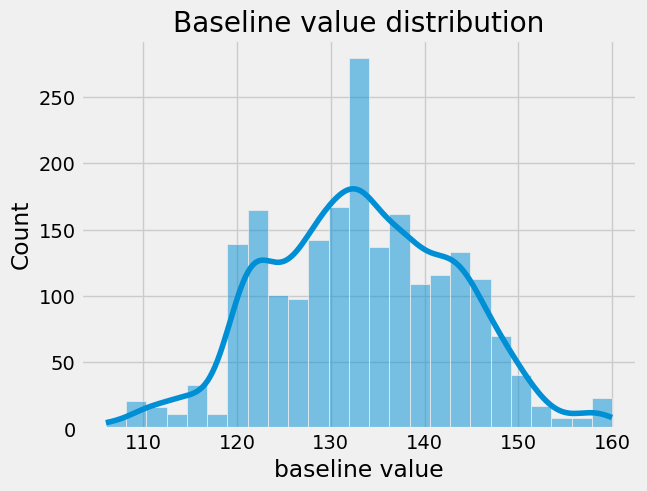

In [8]:
sns.histplot(x = 'baseline value', data = data, kde=True)
plt.title("Baseline value distribution");

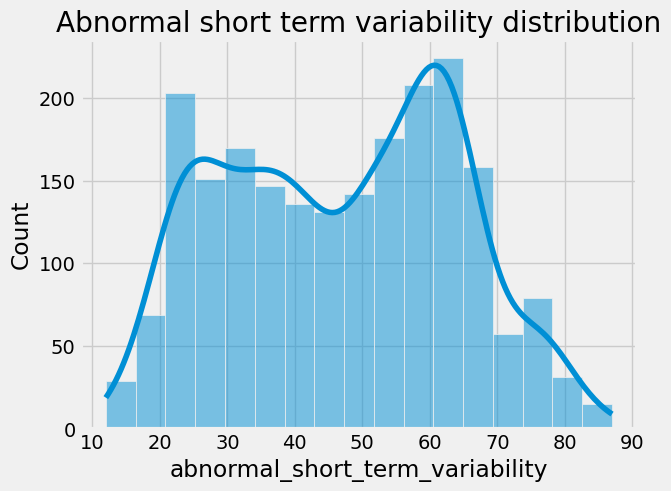

In [9]:
sns.histplot(x = 'abnormal_short_term_variability', data = data, kde=True)
plt.title("Abnormal short term variability distribution");

In [10]:
from ydata_profiling import ProfileReport

In [11]:
profile = ProfileReport(data, title = "Profile report")

In [12]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Dropping duplicate values

In [73]:
data.drop_duplicates(inplace=True)

## Train and test set split

In [74]:
X = data.iloc[:, :-1].values
y = data.iloc[:, -1].values

In [75]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

## Modelling

### Random forest

In [76]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)

RandomForestClassifier()

In [77]:
y_pred = rfc.predict(X_test)

In [78]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.934
Precision score : 0.963
Accuracy score : 0.967


### Naive Bayes

In [79]:
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
gnb.fit(X_train, y_train)

GaussianNB()

In [80]:
y_pred = gnb.predict(X_test)

In [81]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.845
Precision score : 0.716
Accuracy score : 0.844


### Linear SVC

In [82]:
from sklearn.svm import SVC
lsvc = SVC(kernel='linear')
lsvc.fit(X_train, y_train)

SVC(kernel='linear')

In [83]:
y_pred = lsvc.predict(X_test)

In [84]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.802
Precision score : 0.812
Accuracy score : 0.901


### kernel SVC

In [85]:
from sklearn.svm import SVC
ksvc = SVC(kernel='rbf')
ksvc.fit(X_train, y_train)

SVC()

In [86]:
y_pred = ksvc.predict(X_test)

In [87]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.734
Precision score : 0.837
Accuracy score : 0.889


### Logistic Regression

In [88]:
from sklearn.linear_model import LogisticRegression
lgr = LogisticRegression(multi_class = 'multinomial', solver = 'newton-cg')
lgr.fit(X_train, y_train)

LogisticRegression(multi_class='multinomial', solver='newton-cg')

In [89]:
y_pred = lgr.predict(X_test)

In [90]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.804
Precision score : 0.853
Accuracy score : 0.905


### Gradient Boosting classifier

In [91]:
from sklearn.ensemble import GradientBoostingClassifier
gbc = GradientBoostingClassifier(n_estimators=200)
gbc.fit(X_train, y_train)

GradientBoostingClassifier(n_estimators=200)

In [92]:
y_pred = gbc.predict(X_test)

In [93]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.922
Precision score : 0.955
Accuracy score : 0.962


### AdaBoost

In [94]:
from sklearn.ensemble import AdaBoostClassifier
ada = AdaBoostClassifier(n_estimators=100)
ada.fit(X_train, y_train)

AdaBoostClassifier(n_estimators=100)

In [95]:
y_pred = ada.predict(X_test)

In [96]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.845
Precision score : 0.863
Accuracy score : 0.917


### XGBoost

In [97]:
from xgboost import XGBClassifier
xgb = XGBClassifier(n_estimators = 150, n_jobs = -1)
xgb.fit(X_train, y_train - 1)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=150, n_jobs=-1, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [98]:
y_pred = xgb.predict(X_test) + 1

In [99]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Precision score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.927
Precision score : 0.946
Accuracy score : 0.962


### CatBoost

In [100]:
from catboost import CatBoostClassifier
ctb = CatBoostClassifier()
ctb.fit(X_train, y_train, verbose=0)

In [101]:
y_pred = ctb.predict(X_test)

In [102]:
print(f"Recall score : {recall_score(y_test, y_pred, average='macro'):.3f}")
print(f"Recall score : {precision_score(y_test, y_pred, average='macro'):.3f}")
print(f"Accuracy score : {accuracy_score(y_test, y_pred):.3f}")

Recall score : 0.928
Recall score : 0.961
Accuracy score : 0.965


## `CatBoost` is working best for this problem with accuracy : `0.965`

In [104]:
import joblib

joblib.dump(ctb, 'catboost_model.h5')

['catboost_model.h5']